In [ ]:
print("Connected to local runtime!")


Connected to local runtime!


In [ ]:
import pandas as pd
import numpy as np
import cupy as cp
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Update the paths to the location of your datasets on your local machine
dataset1_path = "/home/tamalika/Downloads/Books.csv"
book_data = pd.read_csv(dataset1_path)

dataset2_path = "/home/tamalika/Downloads/Users.csv"
users_data = pd.read_csv(dataset2_path)

dataset3_path = "/home/tamalika/Downloads/Ratings.csv"
ratings_data = pd.read_csv(dataset3_path)

/tmp/ipykernel_105382/422677921.py:10: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  book_data = pd.read_csv(dataset1_path)


In [ ]:
book_data.drop(['Image-URL-S', 'Image-URL-M', 'Image-URL-L'], axis= 1, inplace= True)

In [ ]:
# replacing '-' with '_' and features name in lower case
book_data.columns= book_data.columns.str.strip().str.lower().str.replace('-', '_')
users_data.columns= users_data.columns.str.strip().str.lower().str.replace('-', '_')
ratings_data.columns= ratings_data.columns.str.strip().str.lower().str.replace('-', '_')

In [ ]:
print(book_data.isnull().sum())

isbn                   0
book_title             0
book_author            2
year_of_publication    0
publisher              2
dtype: int64


In [ ]:

# nan values in particular column
book_data.loc[(book_data['book_author'].isnull()),: ]

,isbn,book_title,book_author,year_of_publication,publisher
118033,0751352497,A+ Quiz Masters:01 Earth,NaN,1999,Dorling Kindersley
187689,9627982032,The Credit Suisse Guide to Managing Your Perso...,NaN,1995,Edinburgh Financial Publishing


In [ ]:
# nan values in particular column
book_data.loc[(book_data['publisher'].isnull()),: ]

,isbn,book_title,book_author,year_of_publication,publisher
128890,193169656X,Tyrant Moon,Elaine Corvidae,2002,NaN
129037,1931696993,Finders Keepers,Linnea Sinclair,2001,NaN


In [ ]:
book_data[book_data['year_of_publication'] == 'DK Publishing Inc']

,isbn,book_title,book_author,year_of_publication,publisher
209538,078946697X,"DK Readers: Creating the X-Men, How It All Beg...",2000,DK Publishing Inc,http://images.amazon.com/images/P/078946697X.0...
221678,0789466953,"DK Readers: Creating the X-Men, How Comic Book...",2000,DK Publishing Inc,http://images.amazon.com/images/P/0789466953.0...


In [ ]:
book_data[book_data['year_of_publication'] == 'Gallimard']

,isbn,book_title,book_author,year_of_publication,publisher
220731,2070426769,"Peuple du ciel, suivi de 'Les Bergers\"";Jean-M...",2003,Gallimard,http://images.amazon.com/images/P/2070426769.0...


In [ ]:
# function to fix mismatch data in feature 'book_title', 'book_author', ' year_of_publication', 'publisher'
def replace_df_value(df, idx, col_name, val):
    df.loc[idx, col_name] = val
    return df

In [ ]:
replace_df_value(book_data, 209538, 'book_title', 'DK Readers: Creating the X-Men, How It All Began (Level 4: Proficient Readers)')
replace_df_value(book_data, 209538, 'book_author', 'Michael Teitelbaum')
replace_df_value(book_data, 209538, 'year_of_publication', 2000)
replace_df_value(book_data, 209538, 'publisher', 'DK Publishing Inc')

replace_df_value(book_data, 221678, 'book_title', 'DK Readers: Creating the X-Men, How Comic Books Come to Life (Level 4: Proficient Readers)')
replace_df_value(book_data, 221678, 'book_author', 'James Buckley')
replace_df_value(book_data, 221678, 'year_of_publication', 2000)
replace_df_value(book_data, 221678, 'publisher', 'DK Publishing Inc')

replace_df_value(book_data, 220731,'book_title', "Peuple du ciel, suivi de 'Les Bergers")
replace_df_value(book_data, 220731, 'book_author', 'Jean-Marie Gustave Le ClÃ?Â©zio')
replace_df_value(book_data, 220731, 'year_of_publication', 2003)
replace_df_value(book_data, 220731, 'publisher', 'Gallimard')

,isbn,book_title,book_author,year_of_publication,publisher
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company
...,...,...,...,...,...
271355,0440400988,There's a Bat in Bunk Five,Paula Danziger,1988,Random House Childrens Pub (Mm)
271356,0525447644,From One to One Hundred,Teri Sloat,1991,Dutton Books
271357,006008667X,Lily Dale : The True Story of the Town that Ta...,Christine Wicker,2004,HarperSanFrancisco
271358,0192126040,Republic (World's Classics),Plato,1996,Oxford University Press


In [ ]:
book_data.loc[(book_data['publisher'].isnull()),: ]

,isbn,book_title,book_author,year_of_publication,publisher
128890,193169656X,Tyrant Moon,Elaine Corvidae,2002,NaN
129037,1931696993,Finders Keepers,Linnea Sinclair,2001,NaN


In [ ]:
# replacing 'Nan' with 'No Mention'
book_data.loc[(book_data['isbn'] == '193169656X'),'publisher'] = 'No Mention'
book_data.loc[(book_data['isbn'] == '1931696993'),'publisher'] = 'No Mention'

In [ ]:
df = pd.DataFrame(book_data)
cols = [4]
df = df[df.columns[cols]]

In [ ]:
pd.set_option('display.max_columns', None)
df.head(5)

,publisher
0,Oxford University Press
1,HarperFlamingo Canada
2,HarperPerennial
3,Farrar Straus Giroux
4,W. W. Norton &amp; Company


In [ ]:
book_data[book_data['publisher'] == 'No Mention']

,isbn,book_title,book_author,year_of_publication,publisher
128890,193169656X,Tyrant Moon,Elaine Corvidae,2002,No Mention
129037,1931696993,Finders Keepers,Linnea Sinclair,2001,No Mention


In [ ]:
users_data['age'].fillna((users_data['age'].mean()), inplace=True)

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn

In [ ]:
# retrieving age data between 5 to 90
users_data.loc[(users_data['age'] > 90) | (users_data['age'] < 5)] = np.nan

In [ ]:
users_data['age'].fillna((users_data['age'].mean()), inplace=True)
users_data['age'].unique()

array([34.7514337 , 18.        , 17.        , 61.        , 26.        ,
       14.        , 25.        , 19.        , 46.        , 55.        ,
       32.        , 24.        , 20.        , 34.        , 23.        ,
       51.        , 31.        , 21.        , 44.        , 30.        ,
       57.        , 43.        , 37.        , 41.        , 54.        ,
       42.        , 50.        , 39.        , 53.        , 47.        ,
       36.        , 28.        , 35.        , 13.        , 58.        ,
       49.        , 38.        , 45.        , 62.        , 63.        ,
       27.        , 33.        , 29.        , 66.        , 40.        ,
       15.        , 60.        , 34.73485224, 79.        , 22.        ,
       16.        , 65.        , 59.        , 48.        , 72.        ,
       56.        , 67.        , 80.        , 52.        , 69.        ,
       71.        , 73.        , 78.        ,  9.        , 64.        ,
       12.        , 74.        , 75.        , 76.        , 83.  

In [ ]:
# finding unique ISBNs from rating and book dataset
unique_ratings = ratings_data[ratings_data.isbn.isin(book_data.isbn)]
unique_ratings

,user_id,isbn,book_rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6
...,...,...,...
1149774,276704,0876044011,0
1149775,276704,1563526298,9
1149776,276706,0679447156,0
1149777,276709,0515107662,10


In [ ]:
print(ratings_data.shape)
print(unique_ratings.shape)

(1149780, 3)
(1031136, 3)


In [ ]:

unique_ratings['book_rating'].unique()

array([ 0,  5,  3,  6,  7,  9,  8, 10,  1,  4,  2])

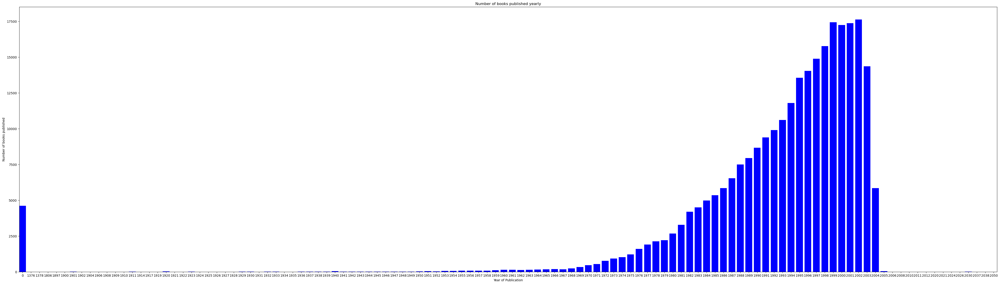

In [ ]:
publications = {}
for year in book_data['year_of_publication']:
    if str(year) not in publications:
        publications[str(year)] = 0
    publications[str(year)] +=1

publications = {k:v for k, v in sorted(publications.items())}

fig = plt.figure(figsize =(55, 15))
plt.bar(list(publications.keys()),list(publications.values()), color = 'blue')
plt.ylabel("Number of books published")
plt.xlabel("Year of Publication")
plt.title("Number of books published yearly")
plt.margins(x = 0)
plt.show()

In [ ]:
book_data.year_of_publication = pd.to_numeric(book_data.year_of_publication, errors='coerce')

# Checking for 0's or NaNs in Year of Publication
zero_year = book_data[book_data.year_of_publication == 0].year_of_publication.count()
nan_year = book_data.year_of_publication.isnull().sum()

print(f'There are {zero_year} entries as \'0\', and {nan_year} NaN entries in the Year of Publication field')

# Replace all years of zero with NaN
book_data.year_of_publication.replace(0, np.nan, inplace=True)

There are 4618 entries as '0', and 0 NaN entries in the Year of Publication field


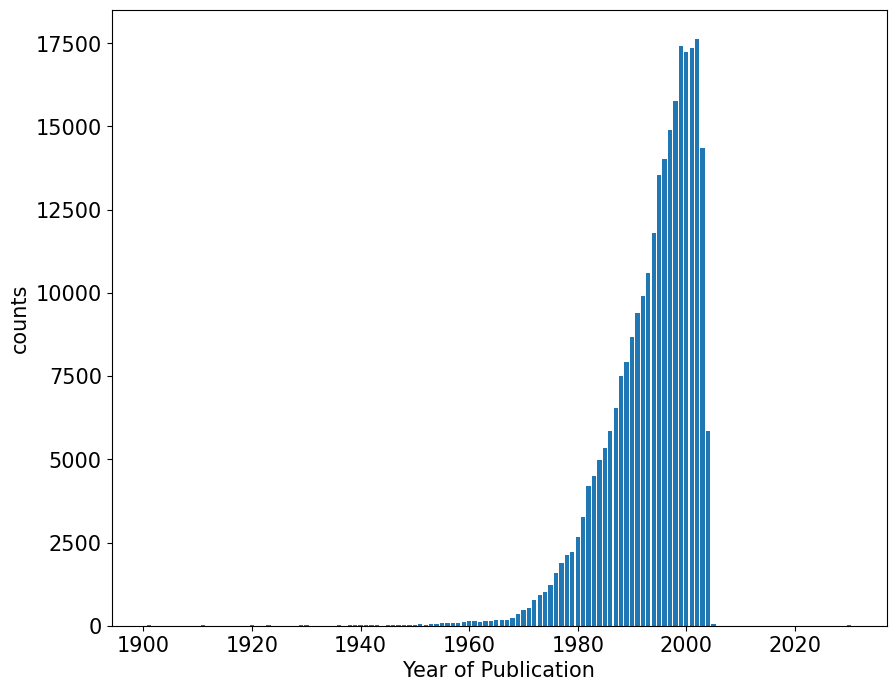

In [ ]:
year = book_data.year_of_publication.value_counts().sort_index()
year = year.where(year>5)
plt.figure(figsize=(10, 8))
plt.rcParams.update({'font.size': 15})
plt.bar(year.index, year.values)
plt.xlabel('Year of Publication')
plt.ylabel('counts')
plt.show()

Text(0.5, 1.0, 'Explicit Ratings')

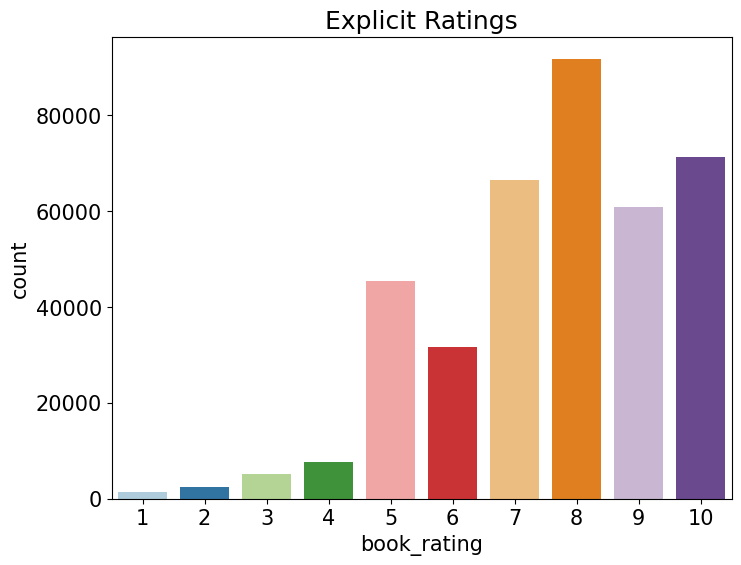

In [ ]:
# Explicit Ratings
plt.figure(figsize=(8,6))
rate_data = unique_ratings[unique_ratings['book_rating'] != 0]
sns.countplot(x="book_rating",palette = 'Paired',data=rate_data)
plt.title("Explicit Ratings")

In [ ]:
ratings_explicit= unique_ratings[unique_ratings['book_rating'] != 0]   # explicit ratings represented by 1–10
ratings_implicit= unique_ratings[unique_ratings['book_rating'] == 0]   # implicit ratings represented by 0

In [ ]:
ratings_explicit.head()

,user_id,isbn,book_rating
1,276726,0155061224,5
3,276729,052165615X,3
4,276729,0521795028,6
8,276744,038550120X,7
16,276747,0060517794,9


In [ ]:
print(unique_ratings.shape)
print(ratings_explicit.shape)

(1031136, 3)
(383842, 3)


In [ ]:
# Merging book_data dataset and ratings_explicit
new_book_df= pd.merge(book_data, ratings_explicit, on='isbn')
new_book_df.head()

,isbn,book_title,book_author,year_of_publication,publisher,user_id,book_rating
0,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,8,5
1,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,11676,8
2,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,67544,8
3,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,116866,9
4,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,123629,9


In [ ]:
new_book_df['book_title'].nunique()

135567

In [ ]:
new_book_df.dtypes

isbn                    object
book_title              object
book_author             object
year_of_publication    float64
publisher               object
user_id                  int64
book_rating              int64
dtype: object

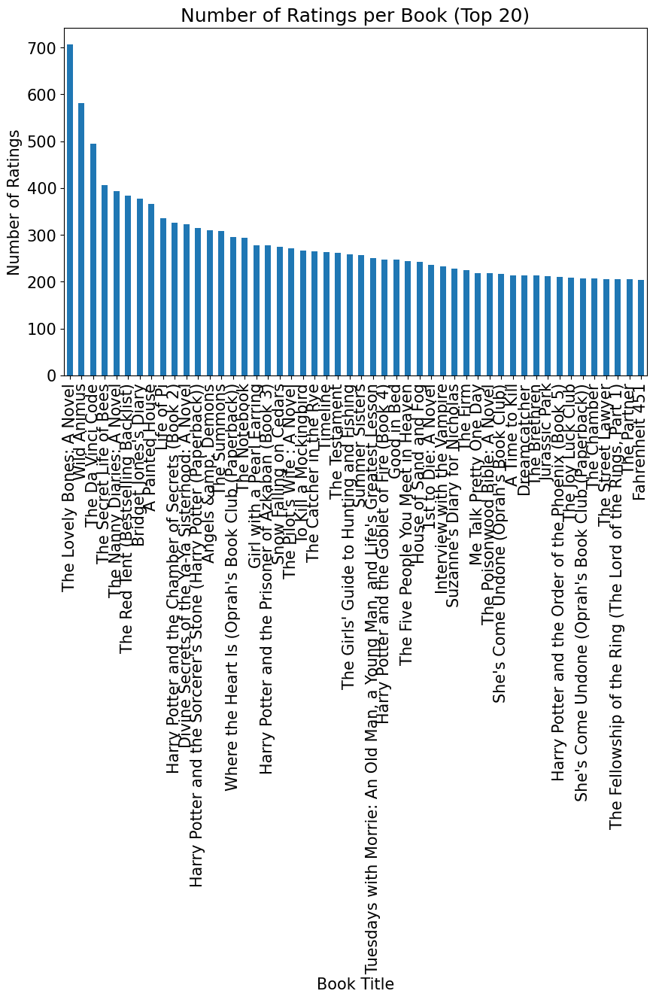

In [ ]:
import matplotlib.pyplot as plt

# Group by book title and count the number of ratings
ratings_count = new_book_df.groupby('book_title')['book_rating'].count()

# Plotting
plt.figure(figsize=(10,6))
ratings_count.sort_values(ascending=False).head(50).plot(kind='bar')
plt.title('Number of Ratings per Book (Top 20)')
plt.xlabel('Book Title')
plt.ylabel('Number of Ratings')
plt.xticks(rotation=90)
plt.show()

In [ ]:
avg_ratings = ratings_count.mean()
print("Average number of ratings received by any book:", avg_ratings)

Average number of ratings received by any book: 2.83138226854618


In [ ]:
num_books_no_ratings = (ratings_count == 0).sum()

print("Number of books that have not received any rating:", num_books_no_ratings)

Number of books that have not received any rating: 0


**My part to size reduce**

In [ ]:
import pandas as pd

# Assuming new_book_df is your DataFrame
# new_book_df = pd.merge(book_data, ratings_explicit, on='isbn')

# Step 1: Count the number of ratings per user
user_rating_counts = new_book_df['user_id'].value_counts()

# Step 2: Filter to retain only users who have rated at least 6 books
users_with_at_least_6_ratings = user_rating_counts[user_rating_counts >= 20].index

# Step 3: Filter the DataFrame to keep only these users
filtered_new_book_df = new_book_df[new_book_df['user_id'].isin(users_with_at_least_6_ratings)]

# Display the resulting DataFrame
filtered_new_book_df.head()


,isbn,book_title,book_author,year_of_publication,publisher,user_id,book_rating
1,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,11676,8
3,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,116866,9
7,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,219008,7
8,0002005018,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,263325,6
11,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999.0,Farrar Straus Giroux,35704,6


In [ ]:
import pandas as pd

# Assuming new_book_df is your DataFrame
# new_book_df = pd.merge(book_data, ratings_explicit, on='isbn')

# Step 1: Count the number of ratings per user
#user_rating_counts = new_book_df['user_id'].value_counts()

# Step 2: Filter to retain only users who have rated at least 6 books
#users_with_at_least_6_ratings = user_rating_counts[user_rating_counts >= 20].index

# Step 3: Filter the DataFrame to keep only these users
#filtered_new_book_df = new_book_df[new_book_df['user_id'].isin(users_with_at_least_6_ratings)]

# Display the resulting DataFrame
#filtered_new_book_df.head()

# Calculate the count of each user ID in the filtered DataFrame
user_id_counts = filtered_new_book_df['user_id'].value_counts()

# Calculate the average count of any user ID being present in a row
avg_user_id_count = user_id_counts.mean()

# Print the count of each user ID
print("Count of each user ID in the filtered data:")
print(user_id_counts)

# Print the average count of any user ID being present in a row
print(f"\nAverage count of any user ID being present in a row: {avg_user_id_count}")

Count of each user ID in the filtered data:
user_id
11676     6943
98391     5691
189835    1899
153662    1845
23902     1180
          ... 
72028       20
245649      20
173122      20
151824      20
229862      20
Name: count, Length: 3305, dtype: int64

Average count of any user ID being present in a row: 65.8786686838124


In [ ]:
import pandas as pd

# Assuming new_book_df is your DataFrame after merging book_data and ratings_explicit
# Assuming you have already filtered for users who have rated at least 6 books
# The previous filtering steps
#user_rating_counts = new_book_df['user_id'].value_counts()
#users_with_at_least_6_ratings = user_rating_counts[user_rating_counts >= 6].index
#filtered_new_book_df = new_book_df[new_book_df['user_id'].isin(users_with_at_least_6_ratings)]

# Count the number of unique books and users before filtering
initial_books_count = filtered_new_book_df['isbn'].nunique()
initial_users_count = filtered_new_book_df['user_id'].nunique()
print(f"Initial number of unique books: {initial_books_count}")
print(f"Initial number of unique users: {initial_users_count}")

# Step 1: Count the number of ratings per book
book_rating_counts = filtered_new_book_df['isbn'].value_counts()

# Step 2: Filter to retain only books rated by at least 19 users
books_with_at_least_20_ratings = book_rating_counts[book_rating_counts >= 2].index

# Step 3: Filter the DataFrame to keep only these books
final_filtered_new_book_df = filtered_new_book_df[filtered_new_book_df['isbn'].isin(books_with_at_least_20_ratings)]

# Count the number of unique books and users after filtering
final_books_count = final_filtered_new_book_df['isbn'].nunique()
final_users_count = final_filtered_new_book_df['user_id'].nunique()

# Display the resulting DataFrame and counts
print(final_filtered_new_book_df.head())
print(f"Final number of unique books: {final_books_count}")
print(f"Final number of unique users: {final_users_count}")


Initial number of unique books: 108380
Initial number of unique users: 3305
          isbn                                         book_title  \
1   0002005018                                       Clara Callan   
3   0002005018                                       Clara Callan   
7   0002005018                                       Clara Callan   
8   0002005018                                       Clara Callan   
11  0374157065  Flu: The Story of the Great Influenza Pandemic...   

             book_author  year_of_publication              publisher  user_id  \
1   Richard Bruce Wright               2001.0  HarperFlamingo Canada    11676   
3   Richard Bruce Wright               2001.0  HarperFlamingo Canada   116866   
7   Richard Bruce Wright               2001.0  HarperFlamingo Canada   219008   
8   Richard Bruce Wright               2001.0  HarperFlamingo Canada   263325   
11      Gina Bari Kolata               1999.0   Farrar Straus Giroux    35704   

    book_rating  
1   

In [ ]:
filtered_new_book_df.shape

(217729, 7)

In [ ]:
final_filtered_new_book_df.shape

(140444, 7)

In [ ]:
unique_users_count = filtered_new_book_df['user_id'].nunique()
print(f"Number of unique users: {unique_users_count}")

Number of unique users: 3305


In [ ]:
unique_users_count = final_filtered_new_book_df['user_id'].nunique()
print(f"Number of unique users: {unique_users_count}")

Number of unique users: 3305


In [ ]:
unique_books_count = final_filtered_new_book_df['isbn'].nunique()
print(f"Number of unique books: {unique_books_count}")

Number of unique books: 31095


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split

# Assuming final_filtered_new_book_df is your DataFrame after filtering users with at least 6 ratings and books rated by at least 20 users
print(f"Initial number of rows: {final_filtered_new_book_df.shape[0]}")

# Split the data into training and testing sets
train_data, test_data = train_test_split(final_filtered_new_book_df, test_size=0.2, random_state=42)

# Ensure all users and items in the test set are present in the training set
train_users = set(train_data['user_id'])
train_items = set(train_data['isbn'])
#///////////////
# Extract unique user_ids and isbns from both the training and testing sets
train_users = set(train_data['user_id'])
train_isbns = set(train_data['isbn'])

test_users = set(test_data['user_id'])
test_isbns = set(test_data['isbn'])

# Check if all users and items in the test set are present in the training set
users_in_both = test_users.issubset(train_users)
isbns_in_both = test_isbns.issubset(train_isbns)

# Print the results
if users_in_both and isbns_in_both:
    print("All users and items in the test data are present in the train data.")
else:
    if not users_in_both:
        print("Some users in the test data are not present in the train data.")
        missing_users = test_users - train_users
        print(f"Missing users: {missing_users}")
        print(f"Number of missing users: {len(missing_users)}")
    if not isbns_in_both:
        print("Some items in the test data are not present in the train data.")
        missing_isbns = test_isbns - train_isbns
        print(f"Missing items: {missing_isbns}")
        print(f"Number of missing items: {len(missing_isbns)}")

#/////////////////////////



# Filter out test entries that have users or items not in the training set
test_data_filtered = test_data[test_data['user_id'].isin(train_users) & test_data['isbn'].isin(train_items)]

# Check if all users and items in test data are present in train data
all_users_in_train = test_data_filtered['user_id'].isin(train_users).all()
all_items_in_train = test_data_filtered['isbn'].isin(train_items).all()

# Print the statement if the condition is met
if all_users_in_train and all_items_in_train:
    print("All users and items in the test data are present in the train data.")
else:
    print("Some users or items in the test data are not present in the train data.")

# Count unique users and items in train, original test, and filtered test sets
unique_train_users = train_data['user_id'].nunique()
unique_train_items = train_data['isbn'].nunique()

unique_test_users = test_data['user_id'].nunique()
unique_test_items = test_data['isbn'].nunique()

unique_test_filtered_users = test_data_filtered['user_id'].nunique()
unique_test_filtered_items = test_data_filtered['isbn'].nunique()

# Print counts of unique users and items
print(f"Training data: {train_data.shape}")
print(f"Unique users in training data: {unique_train_users}")
print(f"Unique items in training data: {unique_train_items}")

print(f"Testing data (original): {test_data.shape}")
print(f"Unique users in original testing data: {unique_test_users}")
print(f"Unique items in original testing data: {unique_test_items}")

print(f"Testing data (filtered): {test_data_filtered.shape}")
print(f"Unique users in filtered testing data: {unique_test_filtered_users}")
print(f"Unique items in filtered testing data: {unique_test_filtered_items}")

# Save or use the final train and test data
train_data.to_csv('train_ratings.csv', index=False)
test_data_filtered.to_csv('test_ratings.csv', index=False)

# Check if any row in test data is also present in train data
common_rows = test_data.merge(train_data).shape[0]
if common_rows > 0:
    print(f"There are {common_rows} common rows between the train and test data.")
else:
    print("There are no common rows between the train and test data.")

Initial number of rows: 140444
Some users in the test data are not present in the train data.
Missing users: {54828}
Number of missing users: 1
Some items in the test data are not present in the train data.
Missing items: {'1573222607', '0786004118', '0380820870', '0786864583', '0345457374', '0843950781', '345309221X', '2266023101', '0061098760', '0804108323', '0345321065', '0440153166', '0886773628', '0060525185', '0373259352', '0061097640', '1551662817', '0375414878', '0590449699', '0786813180', '1892213680', '0064441091', '1555972926', '0439997119', '0836217799', '0380723379', '067103958X', '0679811761', '0684809133', '0446341894', '0394717740', '0385495757', '050552340X', '042517025X', '0486240649', '0449149560', '1852427159', '0812531140', '0380818507', '0395245109', '1557042462', '8420466034', '0880888393', '0671876074', '0553382136', '0689811926', '0312976909', '1893956237', '0961470143', '0590428837', '0590926675', '8478800336', '0373272561', '0060083972', '038070336X', '084394

In [ ]:
user_id_counts_train = train_data['user_id'].value_counts()

# Calculate the average count of any user ID being present in a row
avg_user_id_count_tr = user_id_counts_train.mean()

# Print the count of each user ID
print("Count of each user ID in the train data:")
print(user_id_counts_train)

# Print the average count of any user ID being present in a row
print(f"\nAverage count of any user ID being present in a row: {avg_user_id_count_tr}")


Count of each user ID in the train data:
user_id
11676     3555
98391     2020
153662     783
235105     557
16795      533
          ... 
244375       1
276538       1
274220       1
222054       1
96473        1
Name: count, Length: 3304, dtype: int64

Average count of any user ID being present in a row: 34.005750605326874


In [ ]:
user_id_counts_test = test_data_filtered['user_id'].value_counts()

# Calculate the average count of any user ID being present in a row
avg_user_id_count_ts = user_id_counts_test.mean()

# Print the count of each user ID
print("Count of each user ID in the train data:")
print(user_id_counts_test)

# Print the average count of any user ID being present in a row
print(f"\nAverage count of any user ID being present in a row: {avg_user_id_count_ts}")

Count of each user ID in the train data:
user_id
11676     854
98391     441
153662    186
16795     125
235105    119
         ... 
208788      1
217566      1
41676       1
110887      1
7210        1
Name: count, Length: 3202, dtype: int64

Average count of any user ID being present in a row: 8.365396627108057


In [ ]:
train_data.dtypes

isbn                    object
book_title              object
book_author             object
year_of_publication    float64
publisher               object
user_id                  int64
book_rating              int64
dtype: object

In [ ]:
train_data

,isbn,book_title,book_author,year_of_publication,publisher,user_id,book_rating
305310,0451198883,The Scottish Legacy (Signet Regency Romance),Barbara Hazard,1999.0,Signet Book,85656,7
143158,0060976497,Ten Stupid Things Women Do to Mess Up Their Lives,Laura C. Schlessinger,1995.0,Perennial,93092,7
260653,0020383142,Old New York,Edith Wharton,1995.0,Scribner,248718,9
26717,0553258001,The Cider House Rules,John Irving,1986.0,Bantam Books,53418,8
105155,0446603856,The Enemy Within,Larry Bond,1997.0,Warner Books,11676,7
...,...,...,...,...,...,...,...
237489,0060172096,The Re-Enchantment of Everyday Life,Thomas Moore,1996.0,Harpercollins,115003,7
264038,0307215776,Trixie Belden and the Happy Valley Mystery (Ha...,Kathryn Kenny,1977.0,Random House Childrens Books,40943,10
221087,038067033X,When Bad Things Happen to Good People,Harold S. Kushner,1985.0,Quill,109574,8
309068,0385336594,Crossed Bones,CAROLYN HAINES,2003.0,Delacorte Press,235105,7


In [ ]:
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split

# Assuming final_filtered_new_book_df is your DataFrame after filtering users with at least 6 ratings and books rated by at least 20 users
# Split the data into training and testing sets
#train_data, test_data = train_test_split(final_filtered_new_book_df, test_size=0.2, random_state=42)

# Step 1: Create the User-Book matrix from the training data
user_book_matrix = train_data.pivot(index='user_id', columns='isbn', values='book_rating')

# Step 2: Fill NaN values with 0
user_book_matrix = user_book_matrix.fillna(0)
print("There are no common rows between the train and test data.")

There are no common rows between the train and test data.


In [ ]:
user_book_matrix

isbn,000104799X,0001048082,0001056107,0002005018,0002006588,0002116286,0002184974,0002237458,0002239183,0002244098,0002251760,0002255081,0002259834,0002316196,0002550563,0002553384,0002558122,0003300277,0004125576,000458726X,0004701674,0004704746,0004722124,0004723708,0006157629,0006280803,0006363121,0006370829,0006371248,0006375952,0006379702,0006380263,0006472648,000647425X,000648302X,0006485200,0006485936,0006490603,0006492347,0006497993,000649840X,0006511767,0006512062,0006514480,0006540732,0006543545,0006544959,0006546684,0006547613,0006547834,0006548830,0006550061,0006550193,0006550266,0006550576,0006550789,0006550835,0006550924,0006551971,0006552390,0006716652,0006742939,0006931820,0007100221,0007100922,0007105150,0007106572,0007110928,0007116993,0007119860,000712032X,0007122039,000712855X,0007128568,0007141076,0007144350,0007154607,0007154615,000716226X,0020088248,002011690X,0020125305,0020125607,0020136803,0020198817,0020198906,0020199600,0020199856,0020223722,0020225601,0020248717,0020264763,002026478X,0020264801,0020280505,0020303750,0020306652,002036041X,0020383142,002040400X,0020413904,0020418809,0020427107,0020427115,0020427859,0020442009,0020442106,0020442203,0020442300,0020442408,0020442505,0020442602,0020442807,0020446500,0020449313,0020452705,0020518307,0020518501,0020518609,0020518706,0020518803,0020519001,0020519605,0020532105,0020545304,0020545509,0020633505,0020698461,0020700105,0020811853,0020868308,0020868804,0020868901,0020869002,002086910X,0020869509,002089130X,002411510X,0024182001,0025196359,002542730X,0025439456,0025439472,0026217457,0026301253,0026890380,0027118401,0027153800,0027436292,0027582000,0027617319,0027701301,0028603869,0028603923,0028603958,0028604032,0028604105,0028604199,0028604202,0028604954,0028610105,0028610873,0028613228,0028617363,0028617452,0028619471,0028621697,0028624491,0028625757,0028630092,0028635868,0028641701,0029160030,0030018897,0030085373,0030149010,0030206812,0030448565,0030491916,0030597838,0030597889,0030617316,0030617332,0030632366,0030686784,0030850746,0044409494,0044422776,0048230871,0048231398,0060000805,0060000961,0060001445,0060001453,006000147X,006000150X,0060001801,006000181X,0060001941,0060002050,0060002069,0060002077,0060002492,0060002700,006000438X,006000441X,0060004533,0060004622,006000469X,0060004746,0060005424,0060005556,0060005564,0060005777,0060006048,0060006293,0060006641,0060006897,0060007192,0060007575,0060007761,0060007834,0060008024,0060008032,0060008490,0060008725,0060008776,0060008784,0060008865,0060008873,0060008881,0060009012,0060009225,0060009241,006000925X,0060009292,006000942X,0060011572,0060011904,0060011912,0060011939,006001203X,0060012331,0060012358,0060012781,0060012897,0060013117,0060013125,006001315X,0060013508,0060080841,0060081597,0060081600,0060081961,006008216X,0060082739,0060082895,0060083255,0060083263,0060083298,0060083425,0060083948,0060083956,0060084405,0060084456,006008460X,0060084707,0060085444,0060085452,0060085495,0060085894,0060086246,0060086386,0060086661,0060087358,0060087439,0060088613,0060088877,0060089296,0060089539,0060090251,0060090367,0060090375,0060090383,0060092130,0060092149,0060092181,0060092645,0060092653,0060092661,0060092963,0060093463,006009351X,0060093595,0060094397,0060094850,006009527X,0060096071,0060096195,0060096209,0060097469,0060097574,0060097825,0060097973,0060098538,0060099089,0060099453,0060104910,0060113375,0060114193,0060139145,0060150017,0060152583,0060154969,0060155027,0060155396,0060156732,0060158638,0060158654,0060159081,0060159383,0060160713,0060160772,0060160799,0060161582,0060161647,0060161701,0060162945,0060163747,0060163976,0060164190,0060164662,0060164719,0060165529,0060166932,0060167084,006016722X,0060167688,0060167807,0060168013,0060168218,0060168382,0060168412,006016848X,0060169028,0060169281,0060169435,0060169443,0060169583,0060170166,0060170190,0060170808,006017143X,0060171626,0060171928,0060172096,0060172223,0060172916,0060173076,0060173289,0060173858,0060173963,0060174803,00

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

# Calculate the cosine similarity between users
user_similarity_matrix = cosine_similarity(user_book_matrix)

# Fill the diagonal elements with zeros to avoid self-similarity
np.fill_diagonal(user_similarity_matrix, 0)

# Show the user-user similarity matrix
user_similarity_matrix_df = pd.DataFrame(user_similarity_matrix, index=user_book_matrix.index, columns=user_book_matrix.index)
print("User-User Similarity Matrix:")
user_similarity_matrix_df

User-User Similarity Matrix:


user_id  242       254       507     638     643     651       709     805     \
user_id                                                                         
242         0.0  0.000000  0.000000     0.0     0.0     0.0  0.000000     0.0   
254         0.0  0.000000  0.042083     0.0     0.0     0.0  0.000000     0.0   
507         0.0  0.042083  0.000000     0.0     0.0     0.0  0.000000     0.0   
638         0.0  0.000000  0.000000     0.0     0.0     0.0  0.000000     0.0   
643         0.0  0.000000  0.000000     0.0     0.0     0.0  0.000000     0.0   
...         ...       ...       ...     ...     ...     ...       ...     ...   
278221      0.0  0.000000  0.000000     0.0     0.0     0.0  0.000000     0.0   
278356      0.0  0.108037  0.000000     0.0     0.0     0.0  0.000000     0.0   
278418      0.0  0.000000  0.000000     0.0     0.0     0.0  0.000000     0.0   
278582      0.0  0.000000  0.000000     0.0     0.0     0.0  0.000000     0.0   
278633      0.0  0.000000  0.000000     0.0     0.0     0.0  0.025288     0.0   

user_id  882     929       1025    1131      1211    1248    1424    1435    \
user_id                                                                       
242         0.0     0.0  0.000000     0.0  0.000000     0.0     0.0     0.0   
254         0.0     0.0  0.000000     0.0  0.000000     0.0     0.0     0.0   
507         0.0     0.0  0.000000     0.0  0.000000     0.0     0.0     0.0   
638         0.0     0.0  0.000000     0.0  0.047949     0.0     0.0     0.0   
643         0.0     0.0  0.000000     0.0  0.000000     0.0     0.0     0.0   
...         ...     ...       ...     ...       ...     ...     ...     ...   
278221      0.0     0.0  0.000000     0.0  0.000000     0.0     0.0     0.0   
278356      0.0     0.0  0.000000     0.0  0.000000     0.0     0.0     0.0   
278418      0.0     0.0  0.000000     0.0  0.000000     0.0     0.0     0.0   
278582      0.0     0.0  0.000000     0.0  0.000000     0.0     0.0     0.0   
278633      0.0     0.0  0.042014     0.0  0.000000     0.0     0.0     0.0   

user_id  1674    1733    1848    1903    2024    2030      2033      2110    \
user_id                                                                       
242         0.0     0.0     0.0     0.0     0.0     0.0  0.000000  0.000000   
254         0.0     0.0     0.0     0.0     0.0     0.0  0.039098  0.000000   
507         0.0     0.0     0.0     0.0     0.0     0.0  0.000000  0.000000   
638         0.0     0.0     0.0     0.0     0.0     0.0  0.000000  0.000000   
643         0.0     0.0     0.0     0.0     0.0     0.0  0.000000  0.000000   
...         ...     ...     ...     ...     ...     ...       ...       ...   
278221      0.0     0.0     0.0     0.0     0.0     0.0  0.038421  0.000000   
278356      0.0     0.0     0.0     0.0     0.0     0.0  0.039720  0.000000   
278418      0.0     0.0     0.0     0.0     0.0     0.0  0.000000  0.000000   
278582      0.0     0.0     0.0     0.0     0.0     0.0  0.000000  0.011705   
278633      0.0     0.0     0.0     0.0     0.0     0.0  0.000000  0.000000   

user_id    2179      2276      2313    2358    2363      2766      2891    \
user_id                                                                     
242      0.000000  0.000000  0.105889     0.0     0.0  0.000000  0.000000   
254      0.091628  0.000000  0.030653     0.0     0.0  0.000000  0.029538   
507      0.000000  0.038528  0.000000     0.0     0.0  0.000000  0.042080   
638      0.051518  0.000000  0.000000     0.0     0.0  0.000000  0.000000   
643      0.000000  0.000000  0.000000     0.0     0.0  0.000000  0.000000   
...           ...       ...       ...     ...     ...       ...       ...   
278221   0.000000  0.000000  0.000000     0.0     0.0  0.000000  0.000000   
278356   0.000000  0.000000  0.000000     0.0     0.0  0.000000  0.000000   
278418   0.000000  0.000000  0.000000     0.0     0.0  0.000000  0.000000   
278582   0.000000  0.000000  0.000000     0

In [ ]:
# Count of unique users in the user-user similarity matrix
unique_users_in_similarity_matrix = len(user_similarity_matrix)
print("Count of unique users in user-user similarity matrix:", unique_users_in_similarity_matrix)

# Count of unique users in the filtered DataFrame
unique_users_in_train_data = len(train_data['user_id'].unique())
print("Count of unique users in train DataFrame:", unique_users_in_train_data)

unique_users_in_test_data = len(test_data_filtered['user_id'].unique())
print("Count of unique users in test DataFrame:", unique_users_in_test_data)

Count of unique users in user-user similarity matrix: 3304
Count of unique users in train DataFrame: 3304
Count of unique users in test DataFrame: 3202


In [ ]:
!pip install scikit-surprise


In [ ]:
rmse_list = []
mae_list = []
algorithm_names = []


In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
from surprise import SVD, Dataset, Reader
from surprise import accuracy

# Assuming train_data and test_data_filtered DataFrames are already available
# with columns 'user_id', 'isbn', and 'book_rating'

# Adjust the rating scale according to your dataset
rating_scale = (1, 10)  # Example scale, change to (1, 5) if your ratings are 1 to 5

# Prepare the data for the Surprise library
reader = Reader(rating_scale=rating_scale)
train_data_surprise = Dataset.load_from_df(train_data[['user_id', 'isbn', 'book_rating']], reader)

# Trainset needs to be constructed from the full train data
trainset = train_data_surprise.build_full_trainset()

# Instantiate the SVD model
svd_model = SVD()

# Train the model
svd_model.fit(trainset)

# Prepare the test set for prediction
testset = []
for index, row in test_data_filtered.iterrows():
    testset.append((row['user_id'], row['isbn'], row['book_rating']))

# Make predictions on the test set
predictions = svd_model.test(testset)

# Extract the results
results = [(pred.uid, pred.iid, pred.r_ui, pred.est) for pred in predictions]

# Convert results to DataFrame for better visualization
results_df = pd.DataFrame(results, columns=['user_id', 'isbn', 'actual_rating', 'predicted_rating'])

# Calculate RMSE and MAE
rmse_val = accuracy.rmse(predictions, verbose=True)
mae_val = accuracy.mae(predictions, verbose=True)

# Display the results DataFrame
print("Prediction Results for All Test Users (SVD):")
print(results_df)

# Print RMSE and MAE
print(f"RMSE: {rmse_val}")
print(f"MAE: {mae_val}")

# Append results to the lists
algorithm_names.append('SVD')
rmse_list.append(rmse_val)
mae_list.append(mae_val)


RMSE: 1.5532
MAE:  1.1868
Prediction Results for All Test Users (SVD):
       user_id        isbn  actual_rating  predicted_rating
0       135149  0373218192              8          7.033757
1       228764  051512219X              8          7.862517
2       190459  0451202341              5          7.688785
3       162738  0684853523             10          7.720068
4        40330  0671023373              7          8.193279
...        ...         ...            ...               ...
26781    50225  0140185232              9          7.148713
26782   254299  0316678104              9          7.554468
26783   130554  0689714866              9          6.214246
26784    88677  0446356875              5          7.539304
26785   277427  0425047962              8          8.453210

[26786 rows x 4 columns]
RMSE: 1.5531811656405021
MAE: 1.186812056897303


In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics.pairwise import cosine_similarity
from surprise import SVD, Dataset, Reader
from surprise import accuracy

# Assuming train_data and test_data_filtered DataFrames are already available

# Step 1: Create the User-Book matrix from the training data
# user_book_matrix = train_data.pivot(index='user_id', columns='isbn', values='book_rating').fillna(0)

# Function to calculate mean and variance of item ratings
def calculate_mean_variance(user_book_matrix):
    item_means = user_book_matrix.mean(axis=0)
    item_variances = user_book_matrix.var(axis=0)
    return item_means, item_variances

item_means, item_variances = calculate_mean_variance(user_book_matrix)

# Function to calculate VMD between items
def calculate_vmd(item_means, item_variances, alpha=1.0):
    item_indices = item_means.index
    vmd_matrix = pd.DataFrame(index=item_indices, columns=item_indices)

    for i in item_indices:
        for j in item_indices:
            vmd = abs(item_means[i] - item_means[j]) + alpha * abs(item_variances[i] - item_variances[j])
            vmd_matrix.loc[i, j] = vmd

    return vmd_matrix.astype(float)

# Function to calculate hybrid similarity
def calculate_hybrid_similarity(user_book_matrix, alpha=0.5, beta=0.3, gamma=0.2):
    # Cosine similarity
    cosine_sim = cosine_similarity(user_book_matrix)

    # Pearson similarity
    pearson_sim = user_book_matrix.T.corr(method='pearson')

    # VMD similarity
    item_means, item_variances = calculate_mean_variance(user_book_matrix)
    vmd_sim = calculate_vmd(item_means, item_variances)

    # Combine similarities with weights
    hybrid_sim = alpha * cosine_sim + beta * pearson_sim + gamma * (1 / (1 + vmd_sim))

    return pd.DataFrame(hybrid_sim, index=user_book_matrix.index, columns=user_book_matrix.index)

# Calculate the hybrid similarity matrix
hybrid_similarity_matrix = calculate_hybrid_similarity(user_book_matrix)

# Function to find the top k neighbors
def basic_knn(user_id, user_similarity_matrix, k=20):
    user_similarities = user_similarity_matrix.loc[user_id]
    top_k_neighbors = user_similarities.nlargest(k + 1).iloc[1:].index  # Exclude the user itself

    return top_k_neighbors

# Function to predict rating using basic KNN
def predict_rating_basic_knn(user_id, book_id, user_book_matrix, user_similarity_matrix, k=20):
    neighbors = basic_knn(user_id, user_similarity_matrix, k)
    numerator = 0
    denominator = 0
    for neighbor in neighbors:
        rating_by_neighbor = user_book_matrix.loc[neighbor, book_id]
        if rating_by_neighbor > 0:  # Only consider non-zero ratings
            numerator += rating_by_neighbor * user_similarity_matrix.loc[user_id, neighbor]
            denominator += abs(user_similarity_matrix.loc[user_id, neighbor])

    if denominator == 0:  # If no neighbors have rated the book
        return user_book_matrix.loc[user_id].replace(0, np.nan).mean()  # Use user's mean rating as fallback

    prediction = numerator / denominator

    # Ensure the predicted rating falls within the expected range (e.g., 1 to 10)
    prediction = max(1, min(10, prediction))

    return prediction

# SVD Implementation
# Prepare the data for the Surprise library
reader = Reader(rating_scale=(1, 10))  # Adjust the rating scale according to your dataset
train_data_surprise = Dataset.load_from_df(train_data[['user_id', 'isbn', 'book_rating']], reader)

# Trainset needs to be constructed from the full train data
trainset = train_data_surprise.build_full_trainset()

# Instantiate the SVD model
svd_model = SVD()

# Train the model
svd_model.fit(trainset)

# Prepare the test set for prediction
testset = []
for index, row in test_data_filtered.iterrows():
    testset.append((row['user_id'], row['isbn'], row['book_rating']))

# Make predictions on the test set
predictions_svd = svd_model.test(testset)

# Extract the results for SVD
results_svd = [(pred.uid, pred.iid, pred.r_ui, pred.est) for pred in predictions_svd]
results_df_svd = pd.DataFrame(results_svd, columns=['user_id', 'isbn', 'actual_rating', 'predicted_rating_svd'])

# Define a range of weights for KNN and SVD
weight_range = np.arange(0.0, 1.1, 0.1)
best_rmse = float('inf')
best_mae = float('inf')
best_weights = (0, 0)

# Function to find the optimal weights
def find_optimal_weights():
    global best_rmse, best_mae, best_weights
    for w_knn in weight_range:
        w_svd = 1.0 - w_knn
        results_combined = []

        for index, row in test_data_filtered.iterrows():
            user_id = row['user_id']
            book_id = row['isbn']
            actual_rating = row['book_rating']

            # Predict rating using basic KNN
            predicted_rating_knn = predict_rating_basic_knn(user_id, book_id, user_book_matrix, hybrid_similarity_matrix)

            # Get the SVD prediction
            predicted_rating_svd = results_df_svd[(results_df_svd['user_id'] == user_id) & (results_df_svd['isbn'] == book_id)]['predicted_rating_svd']
            if predicted_rating_svd.empty:
                predicted_rating_svd = user_book_matrix.loc[user_id].replace(0, np.nan).mean()
            else:
                predicted_rating_svd = predicted_rating_svd.values[0]

            # Combine predictions with weights
            combined_prediction = w_knn * predicted_rating_knn + w_svd * predicted_rating_svd

            results_combined.append((user_id, book_id, actual_rating, combined_prediction))

        # Convert combined results to DataFrame for better visualization
        results_df_combined = pd.DataFrame(results_combined, columns=['user_id', 'isbn', 'actual_rating', 'predicted_rating'])

        # Handle any potential NaN values in predicted ratings
        results_df_combined['predicted_rating'].fillna(results_df_combined['actual_rating'].mean(), inplace=True)

        # Calculate RMSE and MAE for the combined model
        rmse_combined = np.sqrt(mean_squared_error(results_df_combined['actual_rating'], results_df_combined['predicted_rating']))
        mae_combined = mean_absolute_error(results_df_combined['actual_rating'], results_df_combined['predicted_rating'])

        if rmse_combined < best_rmse:
            best_rmse = rmse_combined
            best_mae = mae_combined
            best_weights = (w_knn, w_svd)

find_optimal_weights()

# Display the best weights, RMSE, and MAE
print(f"Best weights - KNN: {best_weights[0]}, SVD: {best_weights[1]}")
print(f"Best RMSE: {best_rmse}")
print(f"Best MAE: {best_mae}")

# Append results to the lists
algorithm_names.append('Best weight SVD + basic KNN')
rmse_list.append(best_rmse)
mae_list.append(best_mae)
#with7

Best weights - KNN: 0.2, SVD: 0.8
Best RMSE: 1.5490292349070827
Best MAE: 1.181712824724027


KNN with Triangle-Based Cosine Similarity RMSE: 1.8061825745699218
MAE: 1.3609655288987983

**1.SVD + KNN (Novel Implementation without weight)**

In [ ]:
# Install scikit-surprise library
!pip install scikit-surprise

# Importing necessary libraries
import pandas as pd
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics.pairwise import cosine_similarity
from surprise import SVD, Dataset, Reader
from surprise import accuracy

# Assuming train_data and test_data_filtered DataFrames are already available

# Step 1: Create the User-Book matrix from the training data
user_book_matrix = train_data.pivot(index='user_id', columns='isbn', values='book_rating').fillna(0)

# Function to calculate mean and variance of item ratings
def calculate_mean_variance(user_book_matrix):
    item_means = user_book_matrix.mean(axis=0)
    item_variances = user_book_matrix.var(axis=0)
    return item_means, item_variances

item_means, item_variances = calculate_mean_variance(user_book_matrix)

# Function to calculate VMD between items
def calculate_vmd(item_means, item_variances, alpha=1.0):
    item_indices = item_means.index
    vmd_matrix = pd.DataFrame(index=item_indices, columns=item_indices)

    for i in item_indices:
        for j in item_indices:
            vmd = abs(item_means[i] - item_means[j]) + alpha * abs(item_variances[i] - item_variances[j])
            vmd_matrix.loc[i, j] = vmd

    return vmd_matrix.astype(float)

# Function to calculate hybrid similarity
def calculate_hybrid_similarity(user_book_matrix, alpha=0.5, beta=0.3, gamma=0.2):
    # Cosine similarity
    cosine_sim = cosine_similarity(user_book_matrix)

    # Pearson similarity
    pearson_sim = user_book_matrix.T.corr(method='pearson')

    # VMD similarity
    item_means, item_variances = calculate_mean_variance(user_book_matrix)
    vmd_sim = calculate_vmd(item_means, item_variances)

    # Combine similarities with weights
    hybrid_sim = alpha * cosine_sim + beta * pearson_sim + gamma * (1 / (1 + vmd_sim))

    return pd.DataFrame(hybrid_sim, index=user_book_matrix.index, columns=user_book_matrix.index)

# Calculate the hybrid similarity matrix
hybrid_similarity_matrix = calculate_hybrid_similarity(user_book_matrix)

# Function to find the top k neighbors adaptively
def adaptive_knn(user_id, user_similarity_matrix, min_k=10, max_k=50):
    num_ratings = user_book_matrix.loc[user_id].replace(0, np.nan).count()
    max_possible_ratings = user_book_matrix.shape[1]

    # Adapt k based on the density of user ratings
    k = min_k + int((max_k - min_k) * (num_ratings / max_possible_ratings))

    user_similarities = user_similarity_matrix.loc[user_id]
    top_k_neighbors = user_similarities.nlargest(k + 1).iloc[1:].index  # Exclude the user itself

    return top_k_neighbors

# Function to predict rating using adaptive KNN
def predict_rating_adaptive_knn(user_id, book_id, user_book_matrix, user_similarity_matrix, min_k=10, max_k=50):
    neighbors = adaptive_knn(user_id, user_similarity_matrix, min_k, max_k)
    numerator = 0
    denominator = 0
    for neighbor in neighbors:
        rating_by_neighbor = user_book_matrix.loc[neighbor, book_id]
        if rating_by_neighbor > 0:  # Only consider non-zero ratings
            numerator += rating_by_neighbor * user_similarity_matrix.loc[user_id, neighbor]
            denominator += abs(user_similarity_matrix.loc[user_id, neighbor])

    if denominator == 0:  # If no neighbors have rated the book
        return user_book_matrix.loc[user_id].replace(0, np.nan).mean()  # Use user's mean rating as fallback

    prediction = numerator / denominator

    # Ensure the predicted rating falls within the expected range (e.g., 1 to 10)
    prediction = max(1, min(10, prediction))

    return prediction

# SVD Implementation
# Prepare the data for the Surprise library
reader = Reader(rating_scale=(1, 10))  # Adjust the rating scale according to your dataset
train_data_surprise = Dataset.load_from_df(train_data[['user_id', 'isbn', 'book_rating']], reader)

# Trainset needs to be constructed from the full train data
trainset = train_data_surprise.build_full_trainset()

# Instantiate the SVD model
svd_model = SVD()

# Train the model
svd_model.fit(trainset)

# Prepare the test set for prediction
testset = []
for index, row in test_data_filtered.iterrows():
    testset.append((row['user_id'], row['isbn'], row['book_rating']))

# Make predictions on the test set
predictions_svd = svd_model.test(testset)

# Extract the results for SVD
results_svd = [(pred.uid, pred.iid, pred.r_ui, pred.est) for pred in predictions_svd]
results_df_svd = pd.DataFrame(results_svd, columns=['user_id', 'isbn', 'actual_rating', 'predicted_rating_svd'])

# Combine predictions from KNN and SVD
results_combined = []

for index, row in test_data_filtered.iterrows():
    user_id = row['user_id']
    book_id = row['isbn']
    actual_rating = row['book_rating']

    # Predict rating using adaptive KNN
    predicted_rating_knn = predict_rating_adaptive_knn(user_id, book_id, user_book_matrix, hybrid_similarity_matrix)

    # Get the SVD prediction
    predicted_rating_svd = results_df_svd[(results_df_svd['user_id'] == user_id) & (results_df_svd['isbn'] == book_id)]['predicted_rating_svd']
    if predicted_rating_svd.empty:
        predicted_rating_svd = user_book_matrix.loc[user_id].replace(0, np.nan).mean()
    else:
        predicted_rating_svd = predicted_rating_svd.values[0]

    # Combine predictions with weights
    combined_prediction = 0.5 * predicted_rating_knn + 0.5 * predicted_rating_svd  # Adjust weights as needed

    results_combined.append((user_id, book_id, actual_rating, combined_prediction))

# Convert combined results to DataFrame for better visualization
results_df_combined = pd.DataFrame(results_combined, columns=['user_id', 'isbn', 'actual_rating', 'predicted_rating'])

# Handle any potential NaN values in predicted ratings
results_df_combined['predicted_rating'].fillna(results_df_combined['actual_rating'].mean(), inplace=True)

# Calculate RMSE and MAE for the combined model
rmse_combined = np.sqrt(mean_squared_error(results_df_combined['actual_rating'], results_df_combined['predicted_rating']))
mae_combined = mean_absolute_error(results_df_combined['actual_rating'], results_df_combined['predicted_rating'])

# Display the results DataFrame for the combined model
print("Prediction Results for All Test Users (Hybrid KNN + SVD):")
print(results_df_combined)

# Print RMSE and MAE for the combined model
print(f"Hybrid Model RMSE: {rmse_combined}")
print(f"Hybrid Model MAE: {mae_combined}")

# Append results to the lists
algorithm_names.append('SVD + KNN')
rmse_list.append(rmse_combined)
mae_list.append(mae_combined)



Prediction Results for All Test Users (Hybrid KNN + SVD):
       user_id        isbn  actual_rating  predicted_rating
0       135149  0373218192              8          7.611530
1       228764  051512219X              8          8.131976
2       190459  0451202341              5          7.466085
3       162738  0684853523             10          7.484876
4        40330  0671023373              7          7.945349
...        ...         ...            ...               ...
26781    50225  0140185232              9          7.018771
26782   254299  0316678104              9          7.219219
26783   130554  0689714866              9          6.473104
26784    88677  0446356875              5          7.676361
26785   277427  0425047962              8          8.477735

[26786 rows x 4 columns]
Hybrid Model RMSE: 1.5496643027317192
Hybrid Model MAE: 1.1785182171293977


**Novel Implementation (with weight)**

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.metrics.pairwise import cosine_similarity
from surprise import SVD, Dataset, Reader
from surprise import accuracy

# Assuming train_data and test_data_filtered DataFrames are already available

# Step 1: Create the User-Book matrix from the training data
#user_book_matrix = train_data.pivot(index='user_id', columns='isbn', values='book_rating').fillna(0)

# Function to calculate mean and variance of item ratings
def calculate_mean_variance(user_book_matrix):
    item_means = user_book_matrix.mean(axis=0)
    item_variances = user_book_matrix.var(axis=0)
    return item_means, item_variances

item_means, item_variances = calculate_mean_variance(user_book_matrix)

# Function to calculate VMD between items
def calculate_vmd(item_means, item_variances, alpha=1.0):
    item_indices = item_means.index
    vmd_matrix = pd.DataFrame(index=item_indices, columns=item_indices)

    for i in item_indices:
        for j in item_indices:
            vmd = abs(item_means[i] - item_means[j]) + alpha * abs(item_variances[i] - item_variances[j])
            vmd_matrix.loc[i, j] = vmd

    return vmd_matrix.astype(float)

# Function to calculate hybrid similarity
def calculate_hybrid_similarity(user_book_matrix, alpha=0.5, beta=0.3, gamma=0.2):
    # Cosine similarity
    cosine_sim = cosine_similarity(user_book_matrix)

    # Pearson similarity
    pearson_sim = user_book_matrix.T.corr(method='pearson')

    # VMD similarity
    item_means, item_variances = calculate_mean_variance(user_book_matrix)
    vmd_sim = calculate_vmd(item_means, item_variances)

    # Combine similarities with weights
    hybrid_sim = alpha * cosine_sim + beta * pearson_sim + gamma * (1 / (1 + vmd_sim))

    return pd.DataFrame(hybrid_sim, index=user_book_matrix.index, columns=user_book_matrix.index)

# Calculate the hybrid similarity matrix
hybrid_similarity_matrix = calculate_hybrid_similarity(user_book_matrix)

# Function to find the top k neighbors adaptively
def adaptive_knn(user_id, user_similarity_matrix, min_k=10, max_k=50):
    num_ratings = user_book_matrix.loc[user_id].replace(0, np.nan).count()
    max_possible_ratings = user_book_matrix.shape[1]

    # Adapt k based on the density of user ratings
    k = min_k + int((max_k - min_k) * (num_ratings / max_possible_ratings))

    user_similarities = user_similarity_matrix.loc[user_id]
    top_k_neighbors = user_similarities.nlargest(k + 1).iloc[1:].index  # Exclude the user itself

    return top_k_neighbors

# Function to predict rating using adaptive KNN
def predict_rating_adaptive_knn(user_id, book_id, user_book_matrix, user_similarity_matrix, min_k=10, max_k=50):
    neighbors = adaptive_knn(user_id, user_similarity_matrix, min_k, max_k)
    numerator = 0
    denominator = 0
    for neighbor in neighbors:
        rating_by_neighbor = user_book_matrix.loc[neighbor, book_id]
        if rating_by_neighbor > 0:  # Only consider non-zero ratings
            numerator += rating_by_neighbor * user_similarity_matrix.loc[user_id, neighbor]
            denominator += abs(user_similarity_matrix.loc[user_id, neighbor])

    if denominator == 0:  # If no neighbors have rated the book
        return user_book_matrix.loc[user_id].replace(0, np.nan).mean()  # Use user's mean rating as fallback

    prediction = numerator / denominator

    # Ensure the predicted rating falls within the expected range (e.g., 1 to 10)
    prediction = max(1, min(10, prediction))

    return prediction

# SVD Implementation
# Prepare the data for the Surprise library
reader = Reader(rating_scale=(1, 10))  # Adjust the rating scale according to your dataset
train_data_surprise = Dataset.load_from_df(train_data[['user_id', 'isbn', 'book_rating']], reader)

# Trainset needs to be constructed from the full train data
trainset = train_data_surprise.build_full_trainset()

# Instantiate the SVD model
svd_model = SVD()

# Train the model
svd_model.fit(trainset)

# Prepare the test set for prediction
testset = []
for index, row in test_data_filtered.iterrows():
    testset.append((row['user_id'], row['isbn'], row['book_rating']))

# Make predictions on the test set
predictions_svd = svd_model.test(testset)

# Extract the results for SVD
results_svd = [(pred.uid, pred.iid, pred.r_ui, pred.est) for pred in predictions_svd]
results_df_svd = pd.DataFrame(results_svd, columns=['user_id', 'isbn', 'actual_rating', 'predicted_rating_svd'])
# Function to predict rating using adaptive KNN
def predict_rating_adaptive_knn(user_id, book_id, user_book_matrix, user_similarity_matrix, min_k=10, max_k=50):
    neighbors = adaptive_knn(user_id, user_similarity_matrix, min_k, max_k)
    numerator = 0
    denominator = 0
    for neighbor in neighbors:
        rating_by_neighbor = user_book_matrix.loc[neighbor, book_id]
        if rating_by_neighbor > 0:  # Only consider non-zero ratings
            numerator += rating_by_neighbor * user_similarity_matrix.loc[user_id, neighbor]
            denominator += abs(user_similarity_matrix.loc[user_id, neighbor])

    if denominator == 0:  # If no neighbors have rated the book
        return user_book_matrix.loc[user_id].replace(0, np.nan).mean()  # Use user's mean rating as fallback

    prediction = numerator / denominator

    # Ensure the predicted rating falls within the expected range (e.g., 1 to 10)
    prediction = max(1, min(10, prediction))

    return prediction

# SVD Implementation
# Prepare the data for the Surprise library
reader = Reader(rating_scale=(1, 10))  # Adjust the rating scale according to your dataset
train_data_surprise = Dataset.load_from_df(train_data[['user_id', 'isbn', 'book_rating']], reader)

# Trainset needs to be constructed from the full train data
# Define a range of weights for KNN and SVD
weight_range = np.arange(0.0, 1.1, 0.1)
best_rmse = float('inf')
best_mae = float('inf')
best_weights = (0, 0)
# Function to find the optimal weights
def find_optimal_weights():
    global best_rmse, best_mae, best_weights
    for w_knn in weight_range:
        w_svd = 1.0 - w_knn
        results_combined = []

        for index, row in test_data_filtered.iterrows():
            user_id = row['user_id']
            book_id = row['isbn']
            actual_rating = row['book_rating']

            # Predict rating using adaptive KNN
            predicted_rating_knn = predict_rating_adaptive_knn(user_id, book_id, user_book_matrix, hybrid_similarity_matrix)

            # Get the SVD prediction
            predicted_rating_svd = results_df_svd[(results_df_svd['user_id'] == user_id) & (results_df_svd['isbn'] == book_id)]['predicted_rating_svd']
            if predicted_rating_svd.empty:
                predicted_rating_svd = user_book_matrix.loc[user_id].replace(0, np.nan).mean()
            else:
                predicted_rating_svd = predicted_rating_svd.values[0]

            # Combine predictions with weights
            combined_prediction = w_knn * predicted_rating_knn + w_svd * predicted_rating_svd

            results_combined.append((user_id, book_id, actual_rating, combined_prediction))

        # Convert combined results to DataFrame for better visualization
        results_df_combined = pd.DataFrame(results_combined, columns=['user_id', 'isbn', 'actual_rating', 'predicted_rating'])

        # Handle any potential NaN values in predicted ratings
        results_df_combined['predicted_rating'].fillna(results_df_combined['actual_rating'].mean(), inplace=True)

        # Calculate RMSE and MAE for the combined model
        rmse_combined = np.sqrt(mean_squared_error(results_df_combined['actual_rating'], results_df_combined['predicted_rating']))
        mae_combined = mean_absolute_error(results_df_combined['actual_rating'], results_df_combined['predicted_rating'])

        if rmse_combined < best_rmse:
            best_rmse = rmse_combined
            best_mae = mae_combined
            best_weights = (w_knn, w_svd)

find_optimal_weights()
# Display the best weights, RMSE, and MAE
print(f"Best weights - KNN: {best_weights[0]}, SVD: {best_weights[1]}")
print(f"Best RMSE: {best_rmse}")
print(f"Best MAE: {best_mae}")
# Append results to the lists
algorithm_names.append('Best weight svd + Adaptive KNN')
rmse_list.append(best_rmse)
mae_list.append(best_mae)





Best weights - KNN: 0.30000000000000004, SVD: 0.7
Best RMSE: 1.5449148273798483
Best MAE: 1.1783891607663437
